In [3]:
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import r2_score
import numpy as np
import tensorflow.keras as keras
import tensorflow as tf
import src.tools as tools
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
import tensorflow_addons as tfa
%matplotlib inline
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
stations = ['ParkersBrook','BrownsBrook','GrantPoole']
station_name = stations[2]

wd = f'/datadrive/stream_data/training/{station_name}'
bins = ['val', 'test']
data ={}
for b in bins:
    datatable_name = f'{wd}/{b}_table.csv'
    data[b] = pd.read_csv(datatable_name)

In [5]:
#lets get the y data
test_dataset = tools.create_regression_data_from_dataframe(data['test'])

In [6]:
def dataset_to_array(dataset, batch_size=1):
    "Helper function to get data/labels back from TF dataset"
    for images, labels in dataset.batch(batch_size).take(1):  # only take first element of dataset
        X = images.numpy()
        y = labels.numpy()
    return X,y

In [7]:
input_shape = np.array(Image.open(data['test']['FILENAME'].iloc[0])).shape
xtest, ytest = dataset_to_array(test_dataset,len(test_dataset))

In [ ]:
'''
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
import tensorflow_addons as tfa
num_classes = 1

model = Sequential([
  layers.Conv2D(16, 3, padding='same', activation='relu', input_shape=input_shape),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes)
])
modelname = 'simple_cnn_regression'
jsonfile = f'/datadrive/model/{station_name}/{modelname}/weights/{modelname}.json'
model_json = model.to_json()
with open(jsonfile, "w") as json_file:
    json_file.write(model_json)
'''

In [9]:
#load full model
from tensorflow.keras.models import model_from_json
modelname = 'simple_cnn_regression'
jsonfile = f'/datadrive/model/{station_name}/{modelname}/weights/{modelname}.json'
json_file = open(jsonfile, 'r')
loaded_model_json = json_file.read()
json_file.close()
model = model_from_json(loaded_model_json)
modelname = 'simple_cnn_regression'
weightsfile = f'/datadrive/model/{station_name}/{modelname}/weights/{modelname}.h5'
model.load_weights(weightsfile)
model.compile(optimizer='adam',
              loss='mse',
              metrics=tfa.metrics.RSquare(dtype=tf.float32, y_shape=(1,)))

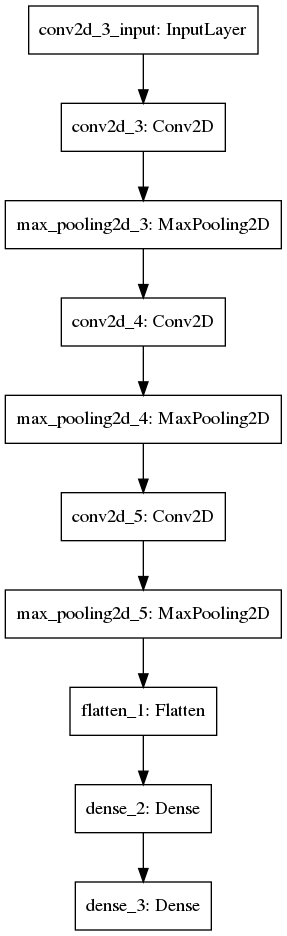

In [10]:
modelfig=f'/datadrive/model/{station_name}/{modelname}/figures/{modelname}_arch.png'
tf.keras.utils.plot_model(
    model, to_file=modelfig, show_shapes=False, show_layer_names=True,
    rankdir='TB', expand_nested=False, dpi=96
)

In [11]:
yhat = model.predict(xtest)

In [12]:
e_ytest, e_yhat = np.exp(ytest),np.exp(yhat)

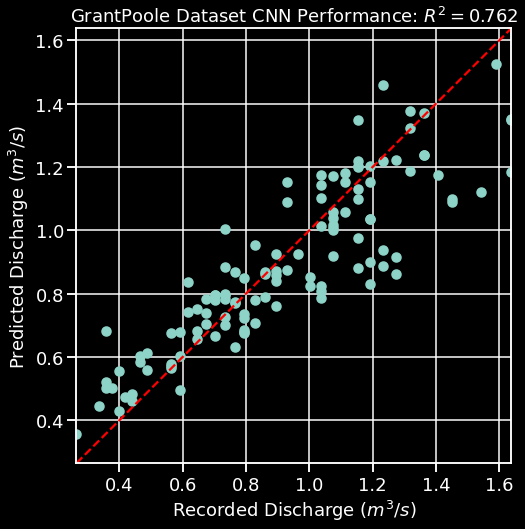

In [28]:
plt.style.use("dark_background")
f,ax = plt.subplots(1,1,figsize=(8,8))
r2 = r2_score(e_ytest, e_yhat)
ax.set_box_aspect(1)
ax.scatter(e_ytest, e_yhat)
ax.set_title(f'{station_name} Dataset CNN Performance: $R^{2}={r2:0.3f}$', fontsize=18)
ax.set_xlabel('Recorded Discharge ($m^{3}/s$)', fontsize=18)
ax.set_ylabel('Predicted Discharge ($m^{3}/s$)', fontsize=18)
ax.tick_params(axis='both', labelsize=18)
lims = [np.min(np.vstack((e_yhat,e_ytest))),np.max(np.vstack((e_yhat,e_ytest)))]
ax.set_xlim(lims)
ax.set_ylim(lims)
ax.plot(lims, lims, color='red', ls='--')
ax.grid(True)
figname = f'/datadrive/model/{station_name}/{modelname}/figures/{modelname}_R2.png'
f.savefig(figname, dpi=300, bbox_inches='tight')
#try to untransform the data
#ax.legend()
#sns.jointplot(x=e_ytest, y=e_yhat, kind='kde', stat_func=r2_score)
#sns.jointplot(x=e_ytest, y=e_yhat, kind='reg', stat_func=r2_score)

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:1184: UserWarning: The following kwargs were not used by contour: 'stat_func'
  **contour_kws,


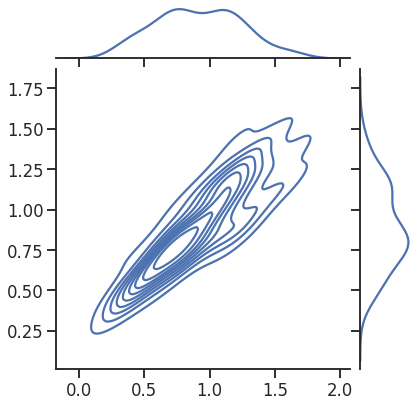

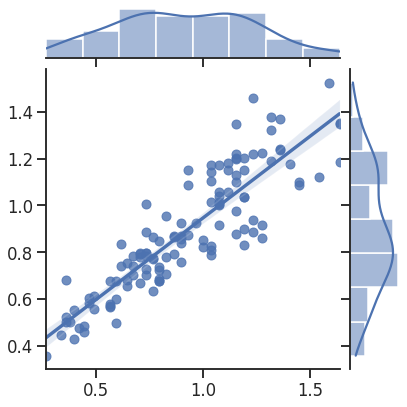

In [25]:
sns.set(style="ticks", context="talk")
from sklearn.metrics import r2_score
sns.jointplot(x=e_ytest.flatten(), y=e_yhat.flatten(), kind='kde', stat_func=r2_score)
sns.jointplot(x=e_ytest.flatten(), y=e_yhat.flatten(), kind='reg')#, stat_func=r2_score)

In [ ]:
# I like the h5 and json format of saving better rather than generating an entire directory
# This is a new method, but I'll vouch to not use it anymore
#modeldirc = f'/datadrive/model/{station_name}/{modelname}'
#model.save(modeldirc)

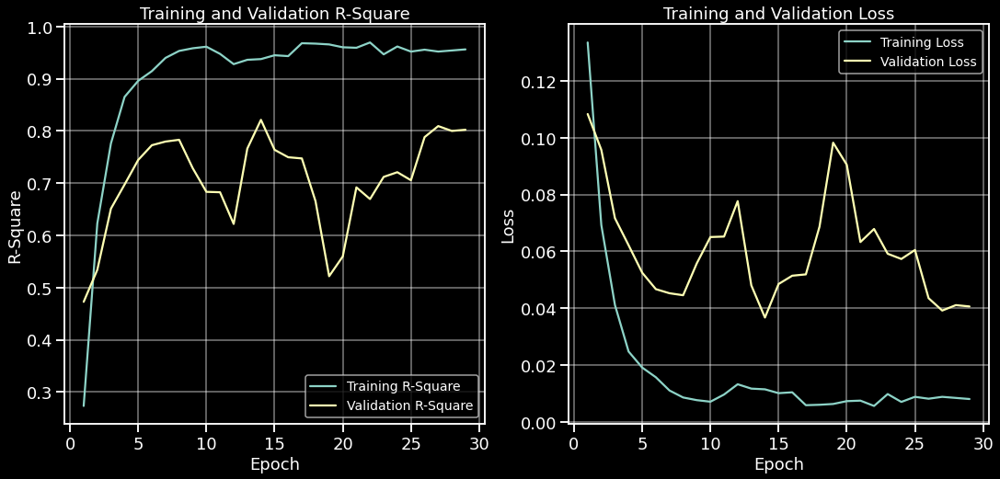

In [27]:
#import in the history
history = pd.read_csv(f'/datadrive/model/{station_name}/{modelname}/history/{modelname}.csv')
acc = history['r_square'][1:]
val_acc = history['val_r_square'][1:]

loss = history['loss'][1:]
val_loss = history['val_loss'][1:]

epochs_range = range(len(history))[1:]

plt.style.use("dark_background")
f, ax = plt.subplots(1,2,figsize=(18,8))
ax[0].plot(epochs_range, acc, label='Training R-Square')
ax[0].plot(epochs_range, val_acc, label='Validation R-Square')
ax[0].legend(loc='lower right', fontsize=14)
ax[0].set_xlabel('Epoch', fontsize=18)
ax[0].set_ylabel('R-Square', fontsize=18)
ax[0].set_title('Training and Validation R-Square', fontsize=18)
ax[0].grid(alpha=0.5)
ax[0].tick_params(axis='both', labelsize=18)

ax[1].plot(epochs_range, loss, label='Training Loss')
ax[1].plot(epochs_range, val_loss, label='Validation Loss')
ax[1].legend(loc='upper right', fontsize=14)
ax[1].set_xlabel('Epoch', fontsize=18)
ax[1].set_ylabel('Loss', fontsize=18)
ax[1].set_title('Training and Validation Loss', fontsize=18)
ax[1].grid(alpha=0.5)
ax[1].tick_params(axis='both', labelsize=18)
figname = f'/datadrive/model/{station_name}/{modelname}/figures/{modelname}_history.png'
f.savefig(figname, dpi=300, bbox_inches='tight')

In [17]:
import matplotlib.cm as cm
import base64
from io import BytesIO
from skimage import io, filters, measure, morphology, img_as_ubyte

def to_png(arr):
    out = BytesIO()
    im = Image.fromarray(arr)
    im.save(out, format='png')
    return out.getvalue()

def b64_image_files(images):
    urls = []
    for im in images:
        png = to_png(img_as_ubyte(im))
        url = 'data:image/png;base64,' + base64.b64encode(png).decode('utf-8')
        urls.append(url)
    return urls

images = [np.array(Image.fromarray(np.array((i*255),dtype=np.uint8)).resize((320,240))) \
          for i in xtest]
img_urls = b64_image_files(images)

In [30]:
from bokeh.io import output_file, show, output_notebook, curdoc
from bokeh.layouts import row
from bokeh.plotting import figure
from bokeh.models import HoverTool, CustomJS, ColumnDataSource, Line
from bokeh.plotting import ColumnDataSource, figure, output_file, show
output_notebook()

#need to shrink the X images to a much smaller size...


source = ColumnDataSource(data=dict(
    x=e_ytest,
    y=e_yhat,
    kbin=np.array(data['test']['KBIN']),
    desc=data['test']['DATETIME'],
    imgs=img_urls,
    fonts=[
        '<i>italics</i>',
        '<pre>pre</pre>',
        '<b>bold</b>',
        '<small>small</small>',
        '<del>del</del>'
    ]
))

TOOLTIPS = """
    <div>
        <div>
            <img
                src="@imgs" height="142" alt="@imgs" width="242"
                style="float: left; margin: 0px 15px 15px 0px;"
                border="2"
            ></img>
        </div>
        <div>
            <span style="font-size: 15px;">Datetime :</span>
            <span style="font-size: 17px; font-weight: bold;">@desc</span>
            <span style="font-size: 15px; color: #966;">[$index]</span>
        </div>
        <div>
            <span style="font-size: 15px;">Class :</span>
            <span style="font-size: 17px; font-weight: bold;">@kbin</span>
            <span style="font-size: 15px; color: #966;">[$index]</span>
        </div>
         
        <div>
            <span style="font-size: 15px;">(ytest, yhat) :</span>
            <span style="font-size: 17px; color: #696; font-weight: bold;">($x, $y)</span>
        </div>
    </div>
"""

curdoc().theme = 'caliber'#'dark_minimal'
p = figure(plot_width=800, plot_height=800, tooltips=TOOLTIPS,
           title=f"{station_name} visual assessment (R2={r2:0.3f})")

p.title.text_font_size = '18pt'

p.circle('x', 'y', size=6, source=source)

p.xaxis.axis_label="Discharge (m3/s)"
p.xaxis.axis_label_text_font_size = "15pt"
p.xaxis.major_label_text_font_size = "15pt"
p.xaxis.axis_label_text_color = "black"

p.yaxis.axis_label="Predicted Discharge (m3/s)"
p.yaxis.axis_label_text_font_size = "15pt"
p.yaxis.major_label_text_font_size = "15pt"
p.yaxis.axis_label_text_color = "black"

output_file(f"/datadrive/model/{station_name}/{modelname}/figures/{modelname}_interactivevisual.html")

#t = show(row(p, img), notebook_handle=True)
l = np.linspace(np.min(lims),np.max(lims),30)
linesource = ColumnDataSource(dict(x=l, y=l))
glyph = Line(x='x', y='y', line_color="#f46d43", line_width=6, line_alpha=0.6)
p.add_glyph(linesource,glyph)

t = show(p, notebook_handle=True)

Loading BokehJS ...